### Importing required library 

In [8]:
import pandas as pd
from scipy import stats
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

### Style, Magic, and Formatter 

#### Seaborn Plot Size
- Set figure size by passing dictionary to rc parameter with key 'figure.figsize'

In [46]:
sns.set(rc={'figure.figsize':(20,10)})


## Reading & Previewing the Data
### Load one of the dataset into the rdf variable

- raw_df type: DataFrame

In [27]:
raw_df = pd.read_pickle("./erml_data/170C278A4218594D54F130A88FF85203.pkl")
raw_df.head(5)

,Temperature,GSR,EOG1,EOG2,EEG1,EEG2,RED_RAW,IR_RAW,Arousal,Dominance,Valence
0,15404.0,14456140.0,15336120.0,16776161.0,4031711.0,14321874.0,63113.0,83255.0,4,5,6
1,15404.0,14341397.0,15336324.0,16776164.0,4483347.0,14300379.0,63113.0,83255.0,4,5,6
2,15404.0,14192337.0,15337673.0,16776194.0,4887349.0,14255666.0,63113.0,83255.0,4,5,6
3,15404.0,14338432.0,15337555.0,16776200.0,4306698.0,14285075.0,63113.0,83255.0,4,5,6
4,15404.0,14421469.0,15337494.0,16776171.0,3842609.0,14288817.0,63113.0,83255.0,4,5,6


### Summary Statistics

In [28]:
raw_df.describe()

,Temperature,GSR,EOG1,EOG2,EEG1,EEG2,RED_RAW,IR_RAW,Arousal,Dominance,Valence
count,278000.000000,2.780000e+05,2.780000e+05,2.780000e+05,2.780000e+05,2.780000e+05,278000.000000,278000.000000,278000.0,278000.0,278000.0
mean,15501.300629,1.426679e+07,1.621342e+07,1.677393e+07,1.001904e+07,6.005880e+06,60919.422766,79941.997442,4.0,5.0,6.0
std,37.779155,4.814708e+06,8.497446e+05,1.765758e+05,6.491528e+06,6.934172e+06,1136.620926,1728.694364,0.0,0.0,0.0
min,15377.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,59007.000000,76784.000000,4.0,5.0,6.0
25%,15481.000000,1.536955e+07,1.592263e+07,1.677617e+07,6.717950e+05,5.450525e+05,59903.000000,78758.000000,4.0,5.0,6.0
50%,15518.000000,1.588633e+07,1.647805e+07,1.677618e+07,1.165216e+07,1.151878e+06,60925.000000,79813.000000,4.0,5.0,6.0
75%,15529.000000,1.628292e+07,1.660904e+07,1.677619e+07,1.622045e+07,1.461219e+07,61768.000000,81298.250000,4.0,5.0,6.0
max,15558.000000,1.677721e+07,1.677716e+07,1.677670e+07,1.677721e+07,1.677721e+07,63607.000000,84210.000000,4.0,5.0,6.0


### Filter out raw data (first 8 columns) of the dataset
* For each subject there are 11 columns in each DataFrame.
* Colums 1-8 are sensor data which are sampled at 250 Hz. Columns 9-11 are the corresponding labels.

In [34]:
sensor_raw_data_df = raw_df.filter(['Temperature', 'GSR', 'EOG1', 'EOG2', 'EEG1', 'EEG2', 'RED_RAW', 'IR_RAW'])
sensor_raw_data_df.head(5)

,Temperature,GSR,EOG1,EOG2,EEG1,EEG2,RED_RAW,IR_RAW
0,15404.0,14456140.0,15336120.0,16776161.0,4031711.0,14321874.0,63113.0,83255.0
1,15404.0,14341397.0,15336324.0,16776164.0,4483347.0,14300379.0,63113.0,83255.0
2,15404.0,14192337.0,15337673.0,16776194.0,4887349.0,14255666.0,63113.0,83255.0
3,15404.0,14338432.0,15337555.0,16776200.0,4306698.0,14285075.0,63113.0,83255.0
4,15404.0,14421469.0,15337494.0,16776171.0,3842609.0,14288817.0,63113.0,83255.0


## Finding outliers in dataset 
Reference: https://medium.datadriveninvestor.com/finding-outliers-in-dataset-using-python-efc3fce6ce32

#### What is an outlier?
An outlier is a data point in a data set that is distant from all other observations. A data point that lies outside the overall distribution of the dataset.

#### What are the criteria to identify an outlier?
- Data point that falls outside of 1.5 times of an interquartile range above the 3rd quartile and below the 1st quartile
- Data point that falls outside of 3 standard deviations. we can use a z score and if the z score falls outside of 2 standard deviation

#### What is the reason for an outlier to exists in a dataset?
An outlier could exist in a dataset due to:
- Variability in the data
- An experimental measurement error

#### What is the impact of an outlier?
Causes serious issues for statistical analysis like:
- Skew the data
- Significant impact on mean
- Significant impact on standard deviation

#### How can we identify an outlier?
- Using scatter plots
- Using Z score
- Using the IQR interquartile range

### Discover outliers with Box Plot
In descriptive statistics, a box plot is a method for graphically depicting groups of numerical data through their quartiles. Box plots may also have lines extending vertically from the boxes (whiskers) indicating variability outside the upper and lower quartiles, hence the terms box-and-whisker plot and box-and-whisker diagram. Outliers may be plotted as individual points.

<AxesSubplot:>

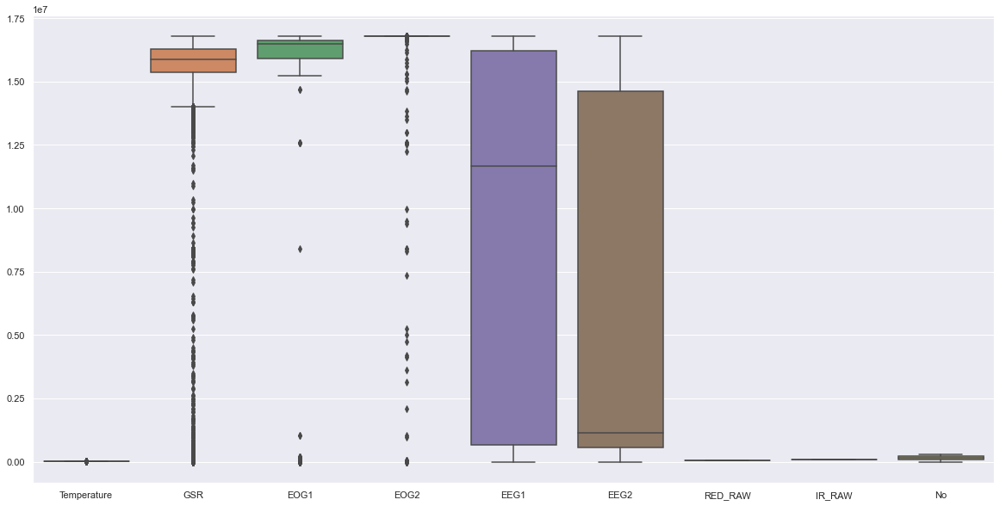

In [52]:
sns.set(rc={'figure.figsize':(20,10)})
sns.boxplot(data=sensor_raw_data_df)

### Discover outliers with Scatter Plot
A scatter plot , is a type of plot or mathematical diagram using Cartesian coordinates to display values for typically two variables for a set of data. The data are displayed as a collection of points, each having the value of one variable determining the position on the horizontal axis and the value of the other variable determining the position on the vertical axis.

#### Counter Column
- Add a new column (No) as an entity counter in Data set
- Move the new column to the first position

In [50]:
numbered_sensor_raw_data_df = sensor_raw_data_df
numbered_sensor_raw_data_df['No'] = np.arange(len(numbered_sensor_raw_data_df))
numbered_sensor_raw_data_df = numbered_sensor_raw_data_df[['No','Temperature', 'GSR', 'EOG1', 'EOG2', 'EEG1', 'EEG2', 'RED_RAW', 'IR_RAW']]
numbered_sensor_raw_data_df.head(5)

,No,Temperature,GSR,EOG1,EOG2,EEG1,EEG2,RED_RAW,IR_RAW
0,0,15404.0,14456140.0,15336120.0,16776161.0,4031711.0,14321874.0,63113.0,83255.0
1,1,15404.0,14341397.0,15336324.0,16776164.0,4483347.0,14300379.0,63113.0,83255.0
2,2,15404.0,14192337.0,15337673.0,16776194.0,4887349.0,14255666.0,63113.0,83255.0
3,3,15404.0,14338432.0,15337555.0,16776200.0,4306698.0,14285075.0,63113.0,83255.0
4,4,15404.0,14421469.0,15337494.0,16776171.0,3842609.0,14288817.0,63113.0,83255.0


In [56]:
g = sns.FacetGrid(numbered_sensor_raw_data_df, col="No")

KeyboardInterrupt: 

<AxesSubplot:xlabel='Temperature', ylabel='GSR'>

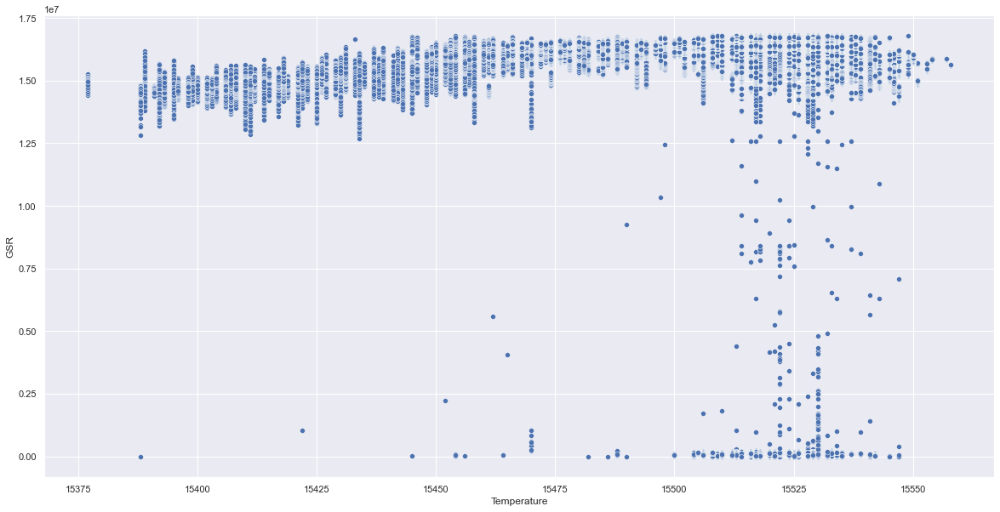

In [54]:
sns.set(rc={'figure.figsize':(20,10)})
sns.scatterplot(x="Temperature", y="GSR", data=numbered_sensor_raw_data_df)

### Remove Outliers Using Z-Score
Reference: https://towardsdatascience.com/ways-to-detect-and-remove-the-outliers-404d16608dba
Remove outliers for all columns using Z-Score, where 3 is considered as the threshold. For reference: 

In [12]:
df_cln_cpy = df[(np.abs(stats.zscore(df)) < 3).all(axis=1)]
df_cln_cpy.count()

Implement min-max normalization for all columns, all values will be normalized between 0 to 1. For reference: https://en.wikipedia.org/wiki/Feature_scaling

In [18]:
norm_result = df.copy()
for feature_name in df.columns: 
    max_value = df[feature_name].max()
    min_value = df[feature_name].min()
    norm_result[feature_name] = (df[feature_name] - min_value) / (max_value - min_value)
norm_result

,Temperature,GSR,EOG1,EOG2,EEG1,EEG2,RED_RAW,IR_RAW
0,0.149171,0.861653,0.914107,0.999968,0.240309,0.853650,0.892609,0.871398
1,0.149171,0.854814,0.914119,0.999968,0.267228,0.852369,0.892609,0.871398
2,0.149171,0.845929,0.914200,0.999970,0.291309,0.849704,0.892609,0.871398
3,0.149171,0.854637,0.914193,0.999970,0.256699,0.851457,0.892609,0.871398
4,0.149171,0.859587,0.914189,0.999968,0.229037,0.851680,0.892609,0.871398
...,...,...,...,...,...,...,...,...
277995,0.801105,0.976569,0.985242,0.999969,0.984254,0.007688,0.115217,0.255319
277996,0.801105,0.977386,0.985247,0.999969,0.984636,0.007815,0.115217,0.255319
277997,0.801105,0.977919,0.985228,0.999969,0.984451,0.007798,0.115217,0.255319
277998,0.801105,0.977055,0.985235,0.999969,0.984575,0.007766,0.115217,0.255319


In [14]:
rdf = pd.read_pickle("./erml_data/170C278A4218594D54F130A88FF85203.pkl")
rdf

,Temperature,GSR,EOG1,EOG2,EEG1,EEG2,RED_RAW,IR_RAW,Arousal,Dominance,Valence
0,15404.0,14456140.0,15336120.0,16776161.0,4031711.0,14321874.0,63113.0,83255.0,4,5,6
1,15404.0,14341397.0,15336324.0,16776164.0,4483347.0,14300379.0,63113.0,83255.0,4,5,6
2,15404.0,14192337.0,15337673.0,16776194.0,4887349.0,14255666.0,63113.0,83255.0,4,5,6
3,15404.0,14338432.0,15337555.0,16776200.0,4306698.0,14285075.0,63113.0,83255.0,4,5,6
4,15404.0,14421469.0,15337494.0,16776171.0,3842609.0,14288817.0,63113.0,83255.0,4,5,6
...,...,...,...,...,...,...,...,...,...,...,...
277995,15522.0,16384102.0,16529564.0,16776179.0,16513047.0,128986.0,59537.0,78680.0,4,5,6
277996,15522.0,16397812.0,16529640.0,16776184.0,16519450.0,131112.0,59537.0,78680.0,4,5,6
277997,15522.0,16406761.0,16529335.0,16776185.0,16516341.0,130823.0,59537.0,78680.0,4,5,6
277998,15522.0,16392256.0,16529440.0,16776182.0,16518429.0,130300.0,59537.0,78680.0,4,5,6


In [17]:
sns.relplot(x="No", y="Temperature", ci=None, kind="line", data=normalized_gsr);

NameError: name 'normalized_gsr' is not defined